#### PPO X GAE

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import moviepy.editor as mpy
import skimage.transform
from IPython.display import Image, display

import tensorflow as tf
import tensorflow_probability as tfp
import tensorflow.keras.losses as kls

ALSA lib confmisc.c:855:(parse_card) cannot find card '0'
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_card_inum returned error: No such file or directory
ALSA lib confmisc.c:422:(snd_func_concat) error evaluating strings
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_concat returned error: No such file or directory
ALSA lib confmisc.c:1334:(snd_func_refer) error evaluating name
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_refer returned error: No such file or directory
ALSA lib conf.c:5701:(snd_config_expand) Evaluate error: No such file or directory
ALSA lib pcm.c:2664:(snd_pcm_open_noupdate) Unknown PCM default
ALSA lib confmisc.c:855:(parse_card) cannot find card '0'
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_card_inum returned error: No such file or directory
ALSA lib confmisc.c:422:(snd_func_concat) error evaluating strings
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_concat returned error: No su

In [2]:
gpus = tf.config.list_physical_devices("GPU") 
if gpus:
    try:
        # Restrict TensorFlow to only use the fourth GPU
        tf.config.set_visible_devices(gpus[0], 'GPU')

        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        
        logical_gpus = tf.config.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

4 Physical GPUs, 1 Logical GPUs


2024-12-15 13:16:45.446173: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-15 13:16:45.577517: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1616] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 26772 MB memory:  -> device: 0, name: Tesla V100-PCIE-32GB, pci bus id: 0000:3b:00.0, compute capability: 7.0


In [3]:
import os
os.environ["SDL_VIDEODRIVER"] = "dummy"  # this line make pop-out window not appear
from ple.games.flappybird import FlappyBird
from ple import PLE

game = FlappyBird()
env = PLE(game, fps=30, display_screen=False)  # environment interface to game
env.reset_game()

test_game = FlappyBird()
test_env = PLE(test_game, fps=30, display_screen=False)
test_env.reset_game()

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


couldn't import doomish
Couldn't import doom


ALSA lib confmisc.c:855:(parse_card) cannot find card '0'
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_card_inum returned error: No such file or directory
ALSA lib confmisc.c:422:(snd_func_concat) error evaluating strings
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_concat returned error: No such file or directory
ALSA lib confmisc.c:1334:(snd_func_refer) error evaluating name
ALSA lib conf.c:5178:(_snd_config_evaluate) function snd_func_refer returned error: No such file or directory
ALSA lib conf.c:5701:(snd_config_expand) Evaluate error: No such file or directory
ALSA lib pcm.c:2664:(snd_pcm_open_noupdate) Unknown PCM default
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: k

In [4]:
path = './movie_f' 
if not os.path.exists(path):
    os.makedirs(path)

In [5]:
hparas = {
    'image_size': 84,
    'num_stack': 4,
    'action_dim': len(env.getActionSet()),
    'hidden_size': 256,
    'lr': 0.0001,
    'gamma': 0.99,
    'lambda': 0.95,
    'clip_val': 0.2,
    'ppo_epochs': 8,
    'test_epochs': 1,
    'num_steps': 512,
    'mini_batch_size': 64,
    'target_reward': 200,
    'max_episode': 30000,
}

In [6]:
# Please do not modify this method
def make_anim(images, fps=60, true_image=False):
    duration = len(images) / fps

    def make_frame(t):
        try:
            x = images[int(len(images) / duration * t)]
        except:
            x = images[-1]

        if true_image:
            return x.astype(np.uint8)
        else:
            return ((x + 1) / 2 * 255).astype(np.uint8)

    clip = mpy.VideoClip(make_frame, duration=duration)
    clip.fps = fps
    
    return clip

In [7]:
def preprocess_screen(screen):
    screen = skimage.transform.rotate(screen, -90, resize=True)
    screen = screen[:400, :]
    screen = skimage.transform.resize(screen, [hparas['image_size'], hparas['image_size'], 1])
    return screen.astype(np.float32)

def frames_to_state(input_frames):
    if(len(input_frames) == 1):
        state = np.concatenate(input_frames*4, axis=-1)
    elif(len(input_frames) == 2):
        state = np.concatenate(input_frames[0:1]*2 + input_frames[1:]*2, axis=-1)
    elif(len(input_frames) == 3):
        state = np.concatenate(input_frames + input_frames[2:], axis=-1)
    else:
        state = np.concatenate(input_frames[-4:], axis=-1)

    return state

In [8]:
class ActorCriticNetwork(tf.keras.Model):
    def __init__(self, hparas):
        super().__init__()

        self.feature_extractor = tf.keras.Sequential([
          # Convolutional Layers
          tf.keras.layers.Conv2D(filters=32, kernel_size=8, strides=4),
          tf.keras.layers.ReLU(),
          tf.keras.layers.Conv2D(filters=64, kernel_size=4, strides=2),
          tf.keras.layers.ReLU(),
          tf.keras.layers.Conv2D(filters=64, kernel_size=3, strides=1),
          tf.keras.layers.ReLU(),
          # Embedding Layers
          tf.keras.layers.Flatten(),
          tf.keras.layers.Dense(hparas['hidden_size']),
          tf.keras.layers.ReLU(),
        ])

        # Actor Network
        self.actor = tf.keras.layers.Dense(hparas['action_dim'], activation='softmax')
        # Critic Network
        self.critic = tf.keras.layers.Dense(1, activation = None)

    def call(self, input):
        x = self.feature_extractor(input)
        action_logits = self.actor(x)
        value = self.critic(x)
        return action_logits, value

In [9]:
class Agent():
    def __init__(self, hparas):
        self.gamma = hparas['gamma']
        self.optimizer = tf.keras.optimizers.Adam(learning_rate=hparas['lr'])
        self.actor_critic = ActorCriticNetwork(hparas)
        self.clip_pram = hparas['clip_val']
    
    def ppo_iter(self, mini_batch_size, states, actions, log_probs, returns, advantage):
        batch_size = states.shape[0]
        for _ in range(batch_size // mini_batch_size):
            rand_ids = tf.convert_to_tensor(np.random.randint(0, batch_size, mini_batch_size), dtype=tf.int32)
            yield tf.gather(states, rand_ids), tf.gather(actions, rand_ids), tf.gather(log_probs, rand_ids), \
             tf.gather(returns, rand_ids), tf.gather(advantage, rand_ids)
    
    def ppo_update(self, ppo_epochs, mini_batch_size, states, actions, log_probs, discount_rewards, advantages):       
        total_actor_loss = 0
        total_critic_loss = 0
        for _ in range(ppo_epochs):
            for state, action, old_log_probs, reward, advantage in self.ppo_iter(mini_batch_size, states, actions, log_probs, discount_rewards, advantages):
                reward = tf.expand_dims(reward, axis=-1)

                with tf.GradientTape() as tape:
                    prob, value = self.actor_critic(state, training=True)
                    dist = tfp.distributions.Categorical(probs=prob, dtype=tf.float32)
                    entropy = tf.math.reduce_mean(dist.entropy())
                    new_log_probs = dist.log_prob(action)

                    # PPO ratio
                    ratio = tf.math.exp(new_log_probs - old_log_probs)
                    surr1 = ratio * advantage
                    surr2 = tf.clip_by_value(ratio, 1.0 - self.clip_pram, 1.0 + self.clip_pram) * advantage

                    actor_loss = tf.math.negative(tf.math.reduce_mean(tf.math.minimum(surr1, surr2))) - 0.1 * entropy
                    critic_loss = 0.5 * tf.math.reduce_mean(kls.mean_squared_error(reward, value))

                    total_loss = actor_loss + critic_loss
            
                # single optimizer
                grads = tape.gradient(total_loss, self.actor_critic.trainable_variables)
                self.optimizer.apply_gradients(zip(grads, self.actor_critic.trainable_variables))
      
                total_actor_loss += actor_loss
                total_critic_loss += critic_loss
        return total_actor_loss, total_critic_loss

In [10]:
# https://arxiv.org/pdf/1506.02438.pdf
# Equation 16
def compute_gae(rewards, masks, values, gamma, LAMBDA):
    gae = 0
    returns = []
    for i in reversed(range(len(rewards))):
        delta = rewards[i] + gamma * values[i + 1] * masks[i] - values[i]
        gae = delta + gamma * LAMBDA * masks[i] * gae
        returns.append(gae + values[i])

    returns.reverse()
    return returns

#### Testing Environment

In [11]:
def test_reward(test_env, agent):
    total_reward = 0
    # Reset the environment
    test_env.reset_game()
    input_frames = [preprocess_screen(test_env.getScreenGrayscale())]

    while not test_env.game_over():

        state = frames_to_state(input_frames)
        state = tf.expand_dims(state, axis=0)
        prob, value = agent.actor_critic(state)

        action = np.argmax(prob[0].numpy())
        reward = test_env.act(test_env.getActionSet()[action])
        total_reward += reward

        input_frames.append(preprocess_screen(test_env.getScreenGrayscale()))

    return total_reward

#### Training

In [12]:
agent = Agent(hparas)
max_episode = hparas['max_episode']
test_per_n_episode = 10
force_save_per_n_episode = 1000
early_stop_reward = 10.0
# early_stop_reward = -1.0

start_s = 0
best_reward = -5.0

checkpoint = tf.train.Checkpoint(
    actor_critic = agent.actor_critic,
    optimizer = agent.optimizer,
)

# Load from old checkpoint
# checkpoint.restore('/home/sysadmin/mpi/lib/Lab15/save/checkpoints/ckpt-2')

In [13]:
ep_reward = []
total_avgr = []
early_stop = False
avg_rewards_list = []

env.reset_game()

for s in range(0, max_episode):
    if early_stop == True:
        break

    rewards = []
    states = []
    actions = []
    log_probs = []
    masks = []
    values = []

    display_frames = [env.getScreenRGB()]
    input_frames = [preprocess_screen(env.getScreenGrayscale())]

    for step in range(hparas['num_steps']):

        state = frames_to_state(input_frames)
        state = tf.expand_dims(state, axis=0)
        prob, value = agent.actor_critic(state)

        dist = tfp.distributions.Categorical(probs=prob[0], dtype=tf.float32)
        action = dist.sample(1)
        log_prob = dist.log_prob(action)

        reward = env.act(env.getActionSet()[int(action.numpy())])

        done = env.game_over()

        states.append(state)
        actions.append(action)
        values.append(value[0])
        log_probs.append(log_prob)
        rewards.append(tf.convert_to_tensor(reward, dtype=tf.float32))
        masks.append(tf.convert_to_tensor(1-int(done), dtype=tf.float32))

        display_frames.append(env.getScreenRGB())
        input_frames.append(preprocess_screen(env.getScreenGrayscale()))

        if done:
            env.reset_game()
            input_frames = [preprocess_screen(env.getScreenGrayscale())]
  
    _, next_value = agent.actor_critic(state)
    values.append(next_value[0])

    returns = compute_gae(rewards, masks, values, hparas['gamma'], hparas['lambda'])

    returns = tf.concat(returns, axis=0)
    log_probs = tf.concat(log_probs, axis=0)
    values = tf.concat(values, axis=0)
    states = tf.concat(states, axis=0)
    actions = tf.concat(actions, axis=0)
    advantage = returns - values[:-1]

    a_loss, c_loss = agent.ppo_update(hparas['ppo_epochs'], hparas['mini_batch_size'], states, actions, log_probs, returns, advantage)
    print('[Episode %d]  Actor loss: %.5f, Critic loss: %.5f' % (s, a_loss, c_loss))

    if s % test_per_n_episode == 0:
        # test agent hparas['test_epochs'] times to get the average reward
        avg_reward = np.mean([test_reward(test_env, agent) for _ in range(hparas['test_epochs'])])
        print("Test average reward is %.1f, Current best average reward is %.1f\n" % (avg_reward, best_reward))
        avg_rewards_list.append(avg_reward)

        if avg_reward > best_reward:
            best_reward = avg_reward
            agent.actor_critic.save('./save/Actor/model_actor_{}_{}'.format(s, avg_reward), save_format="tf")
            checkpoint.save(file_prefix = './save/checkpoints/ckpt')

    if s % force_save_per_n_episode == 0:
        agent.actor_critic.save('./save/Actor/model_actor_{}_{}'.format(s, avg_reward), save_format="tf")
        checkpoint.save(file_prefix = './save/checkpoints/ckpt')
        clip = make_anim(display_frames, fps=60, true_image=True).rotate(-90)
        clip.write_videofile("movie_f/{}_demo-{}.webm".format('Lab15', s), fps=60)
        display(clip.ipython_display(fps=60, autoplay=1, loop=1, maxduration=120))

    if best_reward >= early_stop_reward:
        early_stop = True

2024-12-15 13:16:47.066091: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8907
2024-12-15 13:16:47.217108: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-12-15 13:16:47.218156: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-12-15 13:16:47.218195: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2024-12-15 13:16:47.221465: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-12-15 13:16:47.221740: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.


[Episode 0]  Actor loss: 93.64899, Critic loss: 62.02933
Test average reward is -5.0, Current best average reward is -5.0

()
(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-4.77879941e-02, -6.87865121e-03, -1.23429531e-02, ...,
           7.60282949e-03,  4.76406589e-02,  4.08750784e-04],
         [-3.46900076e-02, -4.57859802e-04,  4.39545996e-02, ...,
           1.20790321e-02, -1.16040353e-02,  4.16692495e-02],
         [ 2.20514964e-02,  2.93467250e-02,  1.44931050e-02, ...,
           2.46917978e-02, -4.75131534e-03,  4.91313115e-02],
         [ 3.25149037e-02, -2.66503338e-02, -4.73243408e-02, ...,
          -2.42615491e-02,  3.25473361e-02, -3.23499739e-02]],

        [[-1.64564997e-02, -3.08586508e-02,  1.44840134e-02, ...,
           3.85029130e-02, -1.03678675e-02,  2.73764245e-02],
         [ 1.71974637e-02, -4.50137742e-02,  2.76282299e-02, ...,
          -2.75278576e-02,  5.13630845e-

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-4.77879941e-02, -6.87865121e-03, -1.23429531e-02, ...,
           7.60282949e-03,  4.76406589e-02,  4.08750784e-04],
         [-3.46900076e-02, -4.57859802e-04,  4.39545996e-02, ...,
           1.20790321e-02, -1.16040353e-02,  4.16692495e-02],
         [ 2.20514964e-02,  2.93467250e-02,  1.44931050e-02, ...,
           2.46917978e-02, -4.75131534e-03,  4.91313115e-02],
         [ 3.25149037e-02, -2.66503338e-02, -4.73243408e-02, ...,
          -2.42615491e-02,  3.25473361e-02, -3.23499739e-02]],

        [[-1.64564997e-02, -3.08586508e-02,  1.44840134e-02, ...,
           3.85029130e-02, -1.03678675e-02,  2.73764245e-02],
         [ 1.71974637e-02, -4.50137742e-02,  2.76282299e-02, ...,
          -2.75278576e-02,  5.13630845e-02, -1.20260542e-04],
         [-4.70625535e-02,  9.67860129e-03, -4.37744968e-02, ...,
          -4.74744216e-02,  2.48695388

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_0_-5.0/assets


()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=1>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

Moviepy - Done !
Moviepy - video ready movie_f/Lab15_demo-0.webm
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


  reward = env.act(env.getActionSet()[int(action.numpy())])



[Episode 1]  Actor loss: 45.39543, Critic loss: 25.20047
[Episode 2]  Actor loss: 42.33555, Critic loss: 17.07509
[Episode 3]  Actor loss: 15.68884, Critic loss: 6.21162
[Episode 4]  Actor loss: 16.42003, Critic loss: 6.50018
[Episode 5]  Actor loss: 3.01396, Critic loss: 3.81569
[Episode 6]  Actor loss: 0.53295, Critic loss: 3.12377
[Episode 7]  Actor loss: -14.49375, Critic loss: 3.61353
[Episode 8]  Actor loss: -6.44951, Critic loss: 2.31037
[Episode 9]  Actor loss: -9.31552, Critic loss: 2.02448
[Episode 10]  Actor loss: -2.47785, Critic loss: 1.99406
Test average reward is -5.0, Current best average reward is -5.0

[Episode 11]  Actor loss: -2.12044, Critic loss: 2.71523
[Episode 12]  Actor loss: -5.88205, Critic loss: 1.21518
[Episode 13]  Actor loss: -9.14046, Critic loss: 1.30702
[Episode 14]  Actor loss: -4.51337, Critic loss: 1.54867
[Episode 15]  Actor loss: -7.43079, Critic loss: 1.38520
[Episode 16]  Actor loss: -5.16577, Critic loss: 1.76187
[Episode 17]  Actor loss: -10.

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.23595437e-02, -7.68480496e-03, -1.41920615e-02, ...,
           8.79390538e-03,  4.83887792e-02,  1.12141029e-03],
         [-3.85002606e-02, -2.96827941e-03,  4.23202515e-02, ...,
           1.27716372e-02, -1.08348029e-02,  4.30299230e-02],
         [ 1.80235486e-02,  2.86765229e-02,  1.31913144e-02, ...,
           2.12204624e-02, -2.74971523e-03,  5.27298413e-02],
         [ 2.89023165e-02, -2.64949016e-02, -5.06086536e-02, ...,
          -2.96413060e-02,  3.45888510e-02, -2.94386633e-02]],

        [[-1.92962810e-02, -3.11287399e-02,  1.27621153e-02, ...,
           3.99905629e-02, -1.08238412e-02,  2.74143349e-02],
         [ 1.37593178e-02, -4.39330526e-02,  2.79604588e-02, ...,
          -2.51868628e-02,  5.12007810e-02, -5.03320189e-06],
         [-4.95093502e-02,  8.95810779e-03, -4.58303615e-02, ...,
          -4.91921790e-02,  2.60659326

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_100_-4.0/assets


()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=2>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

  reward = env.act(env.getActionSet()[int(action.numpy())])



[Episode 101]  Actor loss: -5.51427, Critic loss: 0.24847
[Episode 102]  Actor loss: -2.65337, Critic loss: 0.51047
[Episode 103]  Actor loss: -9.11384, Critic loss: 0.94887
[Episode 104]  Actor loss: -5.63538, Critic loss: 0.56524
[Episode 105]  Actor loss: -8.47222, Critic loss: 0.43482
[Episode 106]  Actor loss: -0.91449, Critic loss: 0.92545
[Episode 107]  Actor loss: 0.36388, Critic loss: 0.50538
[Episode 108]  Actor loss: -6.14311, Critic loss: 2.13651
[Episode 109]  Actor loss: -2.71572, Critic loss: 0.52880
[Episode 110]  Actor loss: -4.20565, Critic loss: 0.44892
Test average reward is -5.0, Current best average reward is -4.0

[Episode 111]  Actor loss: -4.64482, Critic loss: 0.45596
[Episode 112]  Actor loss: -10.32822, Critic loss: 0.67209
[Episode 113]  Actor loss: -8.09812, Critic loss: 0.40232
[Episode 114]  Actor loss: -4.57617, Critic loss: 0.39930
[Episode 115]  Actor loss: -5.42294, Critic loss: 0.59632
[Episode 116]  Actor loss: -9.55239, Critic loss: 0.62512
[Episo

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.39577678e-02, -1.19289607e-02, -1.67130232e-02, ...,
           3.02358158e-03,  5.00176549e-02,  1.17480410e-02],
         [-3.98832448e-02,  1.40985418e-02,  3.96241918e-02, ...,
           8.95881932e-03, -6.01779204e-03,  5.55605106e-02],
         [ 1.68037936e-02,  1.94588173e-02,  1.03376377e-02, ...,
           1.41096897e-02,  2.77361833e-03,  7.11127371e-02],
         [ 2.78257560e-02, -6.61496213e-03, -5.27520441e-02, ...,
          -4.10994217e-02,  4.06366810e-02, -1.13334963e-02]],

        [[-2.09508743e-02, -3.96987572e-02,  1.02478070e-02, ...,
           3.37263979e-02, -1.24732023e-02,  3.76159623e-02],
         [ 1.20126680e-02, -2.45801732e-02,  2.58340221e-02, ...,
          -2.81164646e-02,  5.43684959e-02,  1.68443657e-02],
         [-5.07316440e-02,  6.92449044e-03, -4.86356169e-02, ...,
          -5.23445383e-02,  3.23733464

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_1000_-5.0/assets


()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=3>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

Moviepy - Done !
Moviepy - video ready movie_f/Lab15_demo-1000.webm
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


  reward = env.act(env.getActionSet()[int(action.numpy())])



[Episode 1001]  Actor loss: -3.18210, Critic loss: 0.77261
[Episode 1002]  Actor loss: -2.45725, Critic loss: 0.67501
[Episode 1003]  Actor loss: -27.01641, Critic loss: 3.20126
[Episode 1004]  Actor loss: -4.45482, Critic loss: 1.80640
[Episode 1005]  Actor loss: -2.87136, Critic loss: 1.67080
[Episode 1006]  Actor loss: -12.36232, Critic loss: 1.95916
[Episode 1007]  Actor loss: -1.17552, Critic loss: 1.77571
[Episode 1008]  Actor loss: 1.30271, Critic loss: 1.18744
[Episode 1009]  Actor loss: -0.34320, Critic loss: 1.27784
[Episode 1010]  Actor loss: -12.51406, Critic loss: 1.99091
Test average reward is -5.0, Current best average reward is -4.0

[Episode 1011]  Actor loss: -7.64101, Critic loss: 1.08860
[Episode 1012]  Actor loss: -12.71046, Critic loss: 1.61385
[Episode 1013]  Actor loss: -20.94435, Critic loss: 1.83699
[Episode 1014]  Actor loss: -0.16374, Critic loss: 0.89549
[Episode 1015]  Actor loss: -0.09612, Critic loss: 1.24396
[Episode 1016]  Actor loss: 4.75643, Critic l

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.39577678e-02, -1.19289607e-02, -1.67130232e-02, ...,
           3.02358158e-03,  5.00176549e-02,  1.17480410e-02],
         [-3.98832448e-02,  1.40985418e-02,  3.96241918e-02, ...,
           8.95881932e-03, -6.01779204e-03,  5.55605106e-02],
         [ 1.68037936e-02,  1.94588173e-02,  1.03376377e-02, ...,
           1.41096897e-02,  2.77361833e-03,  7.11127371e-02],
         [ 2.78257560e-02, -6.61496213e-03, -5.27520441e-02, ...,
          -4.10994217e-02,  4.06366810e-02, -1.13334963e-02]],

        [[-2.09508743e-02, -3.96987572e-02,  1.02478070e-02, ...,
           3.37263979e-02, -1.24732023e-02,  3.76159623e-02],
         [ 1.20126680e-02, -2.45801732e-02,  2.58340221e-02, ...,
          -2.81164646e-02,  5.43684959e-02,  1.68443657e-02],
         [-5.07316440e-02,  6.92449044e-03, -4.86356169e-02, ...,
          -5.23445383e-02,  3.23733464

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_1230_1.0/assets
  reward = env.act(env.getActionSet()[int(action.numpy())])



()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=4>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.52604832e-02, -1.19289607e-02, -1.67130232e-02, ...,
           3.02358158e-03,  5.00176549e-02,  1.17480410e-02],
         [-4.11853753e-02,  1.40985418e-02,  3.96241918e-02, ...,
           8.95881932e-03, -6.01779204e-03,  5.55605106e-02],
         [ 1.54947052e-02,  1.94588173e-02,  1.03376377e-02, ...,
           1.41096897e-02,  2.77361833e-03,  7.11127371e-02],
         [ 2.65145507e-02, -6.61496213e-03, -5.27520441e-02, ...,
          -4.10994217e-02,  4.06366810e-02, -1.13334963e-02]],

        [[-2.23019365e-02, -3.96987572e-02,  1.02478070e-02, ...,
           3.37263979e-02, -1.24732023e-02,  3.76159623e-02],
         [ 1.06591256e-02, -2.45801732e-02,  2.58340221e-02, ...,
          -2.81164646e-02,  5.43684959e-02,  1.68443657e-02],
         [-5.20855822e-02,  6.92449044e-03, -4.86356169e-02, ...,
          -5.23445383e-02,  3.23733464

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_2000_-5.0/assets


()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=5>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

Moviepy - Done !
Moviepy - video ready movie_f/Lab15_demo-2000.webm
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


  reward = env.act(env.getActionSet()[int(action.numpy())])



[Episode 2001]  Actor loss: -21.93982, Critic loss: 4.42465
[Episode 2002]  Actor loss: 2.87864, Critic loss: 2.24787
[Episode 2003]  Actor loss: -6.14359, Critic loss: 2.95496
[Episode 2004]  Actor loss: 2.96792, Critic loss: 2.01699
[Episode 2005]  Actor loss: 3.35864, Critic loss: 2.52923
[Episode 2006]  Actor loss: -3.38713, Critic loss: 2.65237
[Episode 2007]  Actor loss: 0.37060, Critic loss: 1.42994
[Episode 2008]  Actor loss: -4.83524, Critic loss: 2.15232
[Episode 2009]  Actor loss: -4.29291, Critic loss: 1.25382
[Episode 2010]  Actor loss: -15.93651, Critic loss: 3.06831
Test average reward is -5.0, Current best average reward is 1.0

[Episode 2011]  Actor loss: -3.74077, Critic loss: 1.72124
[Episode 2012]  Actor loss: -4.85297, Critic loss: 1.29762
[Episode 2013]  Actor loss: -1.96408, Critic loss: 0.59923
[Episode 2014]  Actor loss: -8.04455, Critic loss: 1.85132
[Episode 2015]  Actor loss: -17.80995, Critic loss: 1.51289
[Episode 2016]  Actor loss: -12.70307, Critic loss:

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.52604832e-02, -1.19289607e-02, -1.98675282e-02, ...,
           3.02358158e-03,  5.00176549e-02,  1.17480410e-02],
         [-4.11853753e-02,  1.40985418e-02,  3.64696905e-02, ...,
           8.95881932e-03, -6.01779204e-03,  5.55605106e-02],
         [ 1.54947052e-02,  1.94588173e-02,  7.18311733e-03, ...,
           1.41096897e-02,  2.77361833e-03,  7.11127371e-02],
         [ 2.65145507e-02, -6.61496213e-03, -5.59065454e-02, ...,
          -4.10994217e-02,  4.06366810e-02, -1.13334963e-02]],

        [[-2.23019365e-02, -3.96987572e-02,  7.09346728e-03, ...,
           3.37263979e-02, -1.24732023e-02,  3.76159623e-02],
         [ 1.06591256e-02, -2.45801732e-02,  2.26795170e-02, ...,
          -2.81164646e-02,  5.43684959e-02,  1.68443657e-02],
         [-5.20855822e-02,  6.92449044e-03, -5.17901182e-02, ...,
          -5.23445383e-02,  3.23733464

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_3000_-5.0/assets


()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=6>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

Moviepy - Done !
Moviepy - video ready movie_f/Lab15_demo-3000.webm
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


  reward = env.act(env.getActionSet()[int(action.numpy())])



[Episode 3001]  Actor loss: -31.72600, Critic loss: 3.29780
[Episode 3002]  Actor loss: -10.28464, Critic loss: 4.34130
[Episode 3003]  Actor loss: -1.18371, Critic loss: 4.90465
[Episode 3004]  Actor loss: -6.82837, Critic loss: 5.41319
[Episode 3005]  Actor loss: 12.05008, Critic loss: 7.32691
[Episode 3006]  Actor loss: 28.63079, Critic loss: 8.28659
[Episode 3007]  Actor loss: 23.48327, Critic loss: 4.40923
[Episode 3008]  Actor loss: 8.90217, Critic loss: 2.53648
[Episode 3009]  Actor loss: 9.92678, Critic loss: 1.27759
[Episode 3010]  Actor loss: 6.12485, Critic loss: 1.18920
Test average reward is -4.0, Current best average reward is 1.0

[Episode 3011]  Actor loss: 2.74124, Critic loss: 1.60105
[Episode 3012]  Actor loss: -2.64392, Critic loss: 1.02065
[Episode 3013]  Actor loss: -2.80488, Critic loss: 0.66269
[Episode 3014]  Actor loss: -4.03943, Critic loss: 0.52911
[Episode 3015]  Actor loss: -2.03490, Critic loss: 0.86564
[Episode 3016]  Actor loss: -6.62532, Critic loss: 1

(TrackableReference(name=variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.52604832e-02, -1.19289607e-02, -1.98675282e-02, ...,
           3.02358158e-03,  5.00176549e-02,  1.17480410e-02],
         [-4.11853753e-02,  1.40985418e-02,  3.64696905e-02, ...,
           8.95881932e-03, -6.01779204e-03,  5.55605106e-02],
         [ 1.54947052e-02,  1.94588173e-02,  7.18311733e-03, ...,
           1.41096897e-02,  2.77361833e-03,  7.11127371e-02],
         [ 2.65145507e-02, -6.61496213e-03, -5.59065454e-02, ...,
          -4.10994217e-02,  4.06366810e-02, -1.13334963e-02]],

        [[-2.23019365e-02, -3.96987572e-02,  7.09346728e-03, ...,
           3.37263979e-02, -1.24732023e-02,  3.76159623e-02],
         [ 1.06591256e-02, -2.45801732e-02,  2.26795170e-02, ...,
          -2.81164646e-02,  5.43684959e-02,  1.68443657e-02],
         [-5.20855822e-02,  6.92449044e-03, -5.17901182e-02, ...,
          -5.23445383e-02,  3.23733464

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_3190_9.0/assets
  reward = env.act(env.getActionSet()[int(action.numpy())])



()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=7>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

(TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>), TrackableReference(name=layer_with_weights-0, ref=<keras.layers.convolutional.conv2d.Conv2D object at 0x14549537ad00>), TrackableReference(name=trainable_variables, ref=ListWrapper([<tf.Variable 'conv2d/kernel:0' shape=(8, 8, 4, 32) dtype=float32, numpy=
array([[[[-5.52604832e-02, -1.19289607e-02, -1.98675282e-02, ...,
           3.02358158e-03,  5.00176549e-02,  1.17480410e-02],
         [-4.11853753e-02,  1.40985418e-02,  3.64696905e-02, ...,
           8.95881932e-03, -6.01779204e-03,  5.55605106e-02],
         [ 1.54947052e-02,  1.94588173e-02,  7.18311733e-03, ...,
           1.41096897e-02,  2.77361833e-03,  7.11127371e-02],
         [ 2.65145507e-02, -6.61496213e-03, -5.59065454e-02, ...,
          -4.10994217e-02,  4.06366810e-02, -1.13334963e-02]],

        [[-2.23019365e-02, -3.96987572e-02,  7.09346728e-03, ...,
           3.37263979e-02, -1.24732023e-02,  3.761596

INFO:tensorflow:Assets written to: ./save/Actor/model_actor_3470_13.0/assets


()
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>),)
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Adam object at 0x14549536f850>),)
(TrackableReference(name=save_counter, ref=<tf.Variable 'save_counter:0' shape=() dtype=int64, numpy=8>),)
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=feature_extractor, ref=<keras.engine.sequential.Sequential object at 0x145491a81550>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=actor, ref=<keras.layers.core.dense.Dense object at 0x145491a81670>))
(TrackableReference(name=actor_critic, ref=<__main__.ActorCriticNetwork object at 0x14549537a9d0>), TrackableReference(name=critic, ref=<keras.layers.core.dense.Dense object at 0x1457a665db50>))
(TrackableReference(name=optimizer, ref=<keras.optimizers.optimizer_v2.adam.Ada

In [14]:
print(f'Best reward: {best_reward}')

Best reward: 13.0


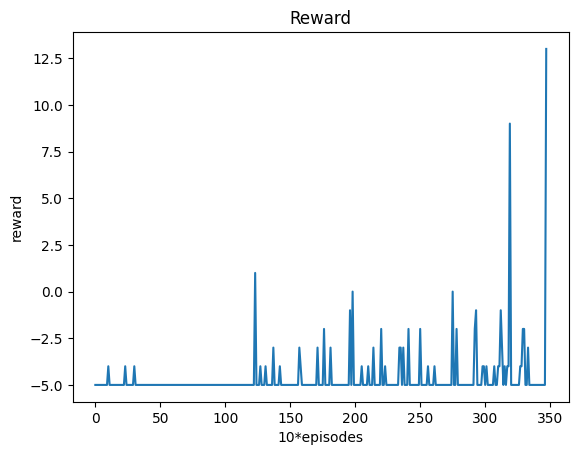

In [15]:
import matplotlib.pyplot as plt

plt.plot(range(len(avg_rewards_list)), avg_rewards_list)
plt.title('Reward')
plt.xlabel('10*episodes')
plt.ylabel('reward')
plt.show()

#### Report

It starts to actually flying over any pipe at around 120*10 = 1200 episodes.
From that on, we keep getting improvement and the trend is that we play better and better, but it's not stable and sometimes even degenerate back to -5.

However, in terms of the convergence, it's quite faster compared to Q-Learning or SARSA. It's just around 1200 episodes to start flying over the pipe and 3500 episodes to get a average of 10, while Q-Learning and SARSA need around 35000 episodes to start flying over the pipe.

Further illustration on how PPO differs from Q-Learning and SARSA:

PPO is a policy gradient method, which means it directly optimizes the policy to maximize the expected return.
And it uses a surrogate objective function to ensure that the policy update does not change the policy too much.
Also, use a Neural Network to approximate the policy function, which is way more memory-efficient than tabular method that we use in last lab.
Most importantly, it is scalable to complex problems and can be used in continuous action spaces.